In [27]:
# Import required libraries
from pyspark.sql import SparkSession
import os
import datetime

import pandas as pd
import csv

In [ ]:
# Create a Spark session to combine the datasets into required format
spark = SparkSession.builder \
    .appName("Combine Datasets") \
    .getOrCreate()

In [ ]:
base_directory = 'dailies'
start_date = datetime.date(2020, 3, 22)
end_date = datetime.date(2022, 10, 12)  # Adjusted to include two full years

In [ ]:
# Define a method to build file paths
def build_file_paths(start_date, end_date, base_directory):
    date_list = []
    current_date = start_date
    while current_date <= end_date:
        date_str = current_date.strftime('%Y-%m-%d')
        file_path = f"{base_directory}/{date_str}/{date_str}_clean-dataset.tsv"
        if os.path.exists(file_path):  # Only add path if file exists
            date_list.append(file_path)
        current_date += datetime.timedelta(days=1)
    return date_list

In [ ]:
file_paths = build_file_paths(start_date, end_date, base_directory)

# Read the first file to create the initial DataFrame
if file_paths:
    combined_df = spark.read.csv(file_paths[0], sep='\t', header=True)

    # Append each subsequent file
    for file_path in file_paths[1:]:
        df = spark.read.csv(file_path, sep='\t', header=True).select('tweet_id','date','time')
        combined_df = combined_df.union(df)
else:
    print("No files found to process.")

In [ ]:
!pip install py4j

if 'combined_df' in locals():
    (combined_df
     .coalesce(1)
     .write.csv('combined_clean_datasets.tsv', sep='\t', header=True, mode='overwrite'))
    print("Combined file written successfully.")
else:
    print("No combined DataFrame to write.")

No combined DataFrame to write.


In [ ]:
df1 = pd.read_csv("D:\output\combined_clean_datasets.tsv\combined_file.csv")
display(df1.head(5))
display(df1.tail(5))

<>:3: SyntaxWarning: invalid escape sequence '\o'
<>:3: SyntaxWarning: invalid escape sequence '\o'
C:\Users\hp\AppData\Local\Temp\ipykernel_4448\1321997749.py:3: SyntaxWarning: invalid escape sequence '\o'
  df1 = pd.read_csv("D:\output\combined_clean_datasets.tsv\combined_file.csv")


In [ ]:
combined_df.tail(10)

[Row(tweet_id='1315865242090590210', date='2020-10-13', time='04:01:35'),
 Row(tweet_id='1315865242274983936', date='2020-10-13', time='04:01:36'),
 Row(tweet_id='1315865242702929920', date='2020-10-13', time='04:01:36'),
 Row(tweet_id='1315865243688427521', date='2020-10-13', time='04:01:36'),
 Row(tweet_id='1315865243868831744', date='2020-10-13', time='04:01:36'),
 Row(tweet_id='1315865244485455872', date='2020-10-13', time='04:01:36'),
 Row(tweet_id='1315865245009747971', date='2020-10-13', time='04:01:36'),
 Row(tweet_id='1315865245248880641', date='2020-10-13', time='04:01:36'),
 Row(tweet_id='1315865245970132997', date='2020-10-13', time='04:01:36'),
 Row(tweet_id='1315865247022940161', date='2020-10-13', time='04:01:37')]

In [ ]:
combined_df.write.csv('combined_data.csv', header=True, mode="overwrite")

In [ ]:
path = 'combined_data.csv/combined.csv'
df2 = pd.read_csv(path)

In [ ]:
# Stop the Spark session
spark.stop

In [ ]:
# Create new Spark session for new task
spark = SparkSession.builder \
    .appName("Combine All Bigrams, Trigrams, Terms in Datasets") \
    .getOrCreate()

In [ ]:
# Import required libraries
import json
from pymongo import MongoClient
from datetime import datetime, timedelta
import math

In [ ]:
# Define a function to merge csv files for all terms, bigrams, trigrams from dailies tweet data collected into mongoDB
def merge_csv_files_to_mongodb(base_directory, file_type, start_date, end_date, mongo_uri, db_name, collection_name):
    # Initialize an empty dictionary to store key-value pairs
    data_dict = {}

    # Initialize a variable to keep track of the total number of key-value pairs inserted
    total_key_value_pairs_inserted = 0

    # Iterate through each date from start_date to end_date
    current_date = start_date
    while current_date <= end_date:
        # Generate date string in 'YYYY-MM-DD' format
        date_str = current_date.strftime('%Y-%m-%d')
        
        # Path to the date folder
        date_folder_path = os.path.join(base_directory, date_str)

        # Check if the folder exists and is a directory
        if os.path.isdir(date_folder_path):
            # Path to the CSV file for the current file type in the date folder
            csv_file_path = os.path.join(date_folder_path, f"{date_str}_top1000{file_type}.csv")

            # Check if the CSV file exists
            if os.path.exists(csv_file_path):
                # Read the CSV file into a DataFrame
                df = pd.read_csv(csv_file_path, header=None)  # Assuming no header in CSV files
                
                # Convert DataFrame to dictionary where col1 values are keys and col2 values are corresponding values
                records = df.set_index(0)[1].to_dict()
                
                # Filter out nan keys
                records = {key: value for key, value in records.items() if not isinstance(key, float) or not math.isnan(key)}
                
                # Update the data dictionary with new key-value pairs
                data_dict.update(records)
                
                # Increment the total number of key-value pairs inserted by the number of key-value pairs in the current DataFrame
                total_key_value_pairs_inserted += len(records)

        # Increment current date by one day
        current_date += timedelta(days=1)

    # Connect to MongoDB
    client = MongoClient(mongo_uri)
    db = client[db_name]
    collection = db[collection_name]

    # Insert data into MongoDB
    collection.insert_one(data_dict)

    print(f"Combined {file_type.capitalize()} CSV data inserted into MongoDB collection '{collection_name}'")
    
    # Return the total number of key-value pairs inserted
    return total_key_value_pairs_inserted

# Define the base directory containing all date folders
base_directory = 'dailies'

# Define the start and end dates
start_date = datetime.strptime('2020-03-22', '%Y-%m-%d')
end_date = datetime.strptime('2020-10-12', '%Y-%m-%d')

# MongoDB connection details
mongo_uri = 'mongodb://localhost:27017/'
db_name = 'TwitterDataset'
collection_terms = 'Terms'
collection_bigrams = 'Bigrams'
collection_trigrams = 'Trigrams'

# Call the merge_csv_files_to_mongodb function for terms, bigrams, and trigrams
total_terms_key_value_pairs = merge_csv_files_to_mongodb(base_directory, 'terms', start_date, end_date, mongo_uri, db_name, collection_terms)
total_bigrams_key_value_pairs = merge_csv_files_to_mongodb(base_directory, 'bigrams', start_date, end_date, mongo_uri, db_name, collection_bigrams)
total_trigrams_key_value_pairs = merge_csv_files_to_mongodb(base_directory, 'trigrams', start_date, end_date, mongo_uri, db_name, collection_trigrams)

print(f"Total key-value pairs inserted for Terms: {total_terms_key_value_pairs}")
print(f"Total key-value pairs inserted for Bigrams: {total_bigrams_key_value_pairs}")
print(f"Total key-value pairs inserted for Trigrams: {total_trigrams_key_value_pairs}")


Combined Terms CSV data inserted into MongoDB collection 'Terms'
Combined Bigrams CSV data inserted into MongoDB collection 'Bigrams'
Combined Trigrams CSV data inserted into MongoDB collection 'Trigrams'
Total key-value pairs inserted for Terms: 205128
Total key-value pairs inserted for Bigrams: 205205
Total key-value pairs inserted for Trigrams: 204204


In [29]:
# Define a function to convert csv to json files for time series analysis
def convert_csv_to_json(directory):
    # List all CSV files in the specified directory
    csv_files = [f for f in os.listdir(directory) if f.endswith('.csv')]

    for file_name in csv_files:
        # Full path to the CSV file
        csv_path = os.path.join(directory, file_name)

        # Read the CSV file into a DataFrame
        df = pd.read_csv(csv_path)

        # Sort DataFrame based on column 2 in descending order and select top 100 rows
        df_sorted = df.sort_values(by=df.columns[1], ascending=False).head(100)

        # Remove rows with NaN values
        df_cleaned = df_sorted.dropna()

        # Convert DataFrame to a dictionary where column 1 is the key and column 2 is the value
        data_dict = df_sorted.set_index(df_sorted.columns[0]).to_dict()[df_sorted.columns[1]]

        # Create a new dictionary to store valid key-value pairs where the value is an integer and key is not 'Nan'
        valid_data_dict = {}

        # Iterate over the key-value pairs and add only those where the value is an integer and key is not 'Nan'
        for key, value in data_dict.items():
            if isinstance(value, int) and key != 'NaN':
                valid_data_dict[key] = value

        # JSON file path
        json_file_path = os.path.join(directory, file_name.replace('.csv', '.json'))

        # Write JSON data to a file
        with open(json_file_path, 'w') as json_file:
            json.dump(valid_data_dict, json_file)

        print(f"Converted {file_name} to JSON.")

In [30]:
# Define start and end dates
base_directory = 'dailies'
start_date = datetime.strptime('2020-03-22', '%Y-%m-%d')
end_date = datetime.strptime('2020-10-12', '%Y-%m-%d')

# Iterate through each date
current_date = start_date
while current_date <= end_date:
    # Generate date string in 'YYYY-MM-DD' format
    date_str = current_date.strftime('%Y-%m-%d')
    
    # Path to the folder with the current date as the name
    folder_path = f"{base_directory}/{date_str}"
    
    # Check if the folder exists
    if os.path.exists(folder_path):
        # Process CSV files in the folder
        convert_csv_to_json(folder_path)

    # Increment current date by one day
    current_date += timedelta(days=1)

# Stop the SparkSession
spark.stop()

AttributeError: module 'datetime' has no attribute 'strptime'

Modifying files in local directory (Not to MongoDB)

In [ ]:
#Define a function to create csv files for terms, bigrams, trigrams from json having data and dictionary of data collected on that day
def create_csv_files(base_directory):
    # Create CSV files for terms, bigrams, and trigrams
    terms_csv_path = 'terms.csv'
    bigrams_csv_path = 'bigrams.csv'
    trigrams_csv_path = 'trigrams.csv'

    # Write header rows for CSV files
    with open(terms_csv_path, 'w', newline='') as terms_csv:
        csv.writer(terms_csv).writerow(['Date', 'Terms Data'])

    with open(bigrams_csv_path, 'w', newline='') as bigrams_csv:
        csv.writer(bigrams_csv).writerow(['Date', 'Bigrams Data'])

    with open(trigrams_csv_path, 'w', newline='') as trigrams_csv:
        csv.writer(trigrams_csv).writerow(['Date', 'Trigrams Data'])

    # Iterate over each folder
    for folder_name in sorted(os.listdir(base_directory)):
        folder_path = os.path.join(base_directory, folder_name)

        # Extract date from folder name
        date = folder_name

        # Read data from JSON files in the folder
        terms_json_path = os.path.join(folder_path, f'{folder_name}_top1000terms.json')
        bigrams_json_path = os.path.join(folder_path, f'{folder_name}_top1000bigrams.json')
        trigrams_json_path = os.path.join(folder_path, f'{folder_name}_top1000trigrams.json')

        # Write data to corresponding CSV files
        write_json_to_csv(date, terms_json_path, terms_csv_path)
        write_json_to_csv(date, bigrams_json_path, bigrams_csv_path)
        write_json_to_csv(date, trigrams_json_path, trigrams_csv_path)


# Define a function to write data from json to csv file
def write_json_to_csv(date, json_file_path, csv_file_path):
    if os.path.exists(json_file_path):
        with open(json_file_path, 'r', encoding='utf-8') as json_file:
            data = json.load(json_file)
        
        # Convert data to dictionary with string keys and integer values
        data_dict = {str(key): int(value) for key, value in data.items()}
        # Write data to CSV file with utf-8 encoding
        with open(csv_file_path, 'a', newline='', encoding='utf-8') as csv_file:
            csv.writer(csv_file).writerow([date, data_dict])

        print(f"Added data from {date} to {csv_file_path}.")
    else:
        print(f"JSON file not found in {date}.")


# Example usage
base_directory = 'dailies'
create_csv_files(base_directory)


Added data from 2020-03-22 to terms.csv.
Added data from 2020-03-22 to bigrams.csv.
Added data from 2020-03-22 to trigrams.csv.
Added data from 2020-03-23 to terms.csv.
Added data from 2020-03-23 to bigrams.csv.
Added data from 2020-03-23 to trigrams.csv.
Added data from 2020-03-24 to terms.csv.
Added data from 2020-03-24 to bigrams.csv.
Added data from 2020-03-24 to trigrams.csv.
Added data from 2020-03-25 to terms.csv.
Added data from 2020-03-25 to bigrams.csv.
Added data from 2020-03-25 to trigrams.csv.
Added data from 2020-03-26 to terms.csv.
Added data from 2020-03-26 to bigrams.csv.
Added data from 2020-03-26 to trigrams.csv.
Added data from 2020-03-27 to terms.csv.
Added data from 2020-03-27 to bigrams.csv.
Added data from 2020-03-27 to trigrams.csv.
Added data from 2020-03-28 to terms.csv.
Added data from 2020-03-28 to bigrams.csv.
Added data from 2020-03-28 to trigrams.csv.
Added data from 2020-03-29 to terms.csv.
Added data from 2020-03-29 to bigrams.csv.
Added data from 2020

In [31]:
import os
import csv
from pymongo import MongoClient

def load_csv_file_to_mongodb(csv_file, mongo_uri, db_name, collection_name):
    # Connect to MongoDB
    client = MongoClient(mongo_uri)
    db = client[db_name]
    collection = db[collection_name]

    # Open the CSV file
    with open(csv_file, 'r', encoding='utf-8') as file:
        # Create a CSV reader object
        reader = csv.DictReader(file)
        # Insert each row as a document into MongoDB
        for row in reader:
            collection.insert_one(row)
    print(f"Data from {csv_file} inserted into MongoDB collection '{collection_name}'")

# Define the CSV files and corresponding collection names
csv_collections = {
    'terms.csv': 'TermsCSV',
    'bigrams.csv': 'BigramsCSV',
    'trigrams.csv': 'TrigramsCSV'
}

# MongoDB connection details
mongo_uri = 'mongodb://localhost:27017/'
db_name = 'TwitterDataset'

# Load each CSV file into MongoDB
for csv_file, collection_name in csv_collections.items():
    load_csv_file_to_mongodb(csv_file, mongo_uri, db_name, collection_name)


Data from terms.csv inserted into MongoDB collection 'TermsCSV'
Data from bigrams.csv inserted into MongoDB collection 'BigramsCSV'
Data from trigrams.csv inserted into MongoDB collection 'TrigramsCSV'


In [39]:
import pandas as pd
import ast
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from wordcloud import WordCloud
from collections import Counter

In [40]:
from pymongo import MongoClient
import pandas as pd

# MongoDB connection details
mongo_uri = 'mongodb://localhost:27017/'
db_name = 'TwitterDataset'
collection_name = 'BigramsCSV'

# Connect to MongoDB
client = MongoClient(mongo_uri)
db = client[db_name]
collection = db[collection_name]

# Query all documents from the collection
cursor = collection.find()

# Convert the cursor to a list of dictionaries
data = list(cursor)

# Convert the list of dictionaries to a DataFrame
df = pd.DataFrame(data)

# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date'])

# Rename columns if necessary
df.rename(columns={'Bigrams Data': 'Counts'}, inplace=True)

# Display the DataFrame
print(df.head(10))


                        _id       Date  \
0  663c2070b60ba3adaa977c2d 2020-03-22   
1  663c2070b60ba3adaa977c2e 2020-03-23   
2  663c2070b60ba3adaa977c2f 2020-03-24   
3  663c2070b60ba3adaa977c30 2020-03-25   
4  663c2070b60ba3adaa977c31 2020-03-26   
5  663c2070b60ba3adaa977c32 2020-03-27   
6  663c2070b60ba3adaa977c33 2020-03-28   
7  663c2070b60ba3adaa977c34 2020-03-29   
8  663c2070b60ba3adaa977c35 2020-03-30   
9  663c2070b60ba3adaa977c36 2020-03-31   

                                              Counts  
0  {'covid 19': 63056, 'stay home': 4573, 'positi...  
1  {'covid 19': 79421, 'stay home': 5777, 'corona...  
2  {'covid 19': 85876, 'coronavirus pandemic': 58...  
3  {'covid 19': 85937, 'prince charles': 6287, 'c...  
4  {'covid 19': 120843, 'coronavirus pandemic': 8...  
5  {'covid 19': 125985, 'boris johnson': 9689, 'c...  
6  {'covid 19': 109444, 'coronavirus covid19': 76...  
7  {'covid 19': 110352, 'coronavirus covid19': 75...  
8  {'covid 19': 130436, 'coronavirus covid

In [41]:
# Convert Date column to datetime type
df['Date'] = pd.to_datetime(df['Date'])

# Evaluate string representations of dictionaries in the 'Bigrams Data' column
df['Counts'] = df['Counts'].apply(ast.literal_eval)

# Set the 'Date' as the index of the DataFrame
df.set_index('Date', inplace=True)

In [42]:
from collections import Counter

# Define a function to sum dictionaries of frequencies
def sum_bigram_counts(bigram_list):
    total_counts = Counter()
    for bigrams in bigram_list:
        total_counts.update(bigrams)
    return dict(total_counts)  # Ensure it returns a simple dictionary

# Aggregate the bigram data weekly using the custom function
weekly_data = df['Counts'].resample('W').agg(sum_bigram_counts)

# Check the output (optional debugging step)
print(weekly_data.head())
print(weekly_data.iloc[0])

Date
2020-03-22    {'covid 19': 63056, 'stay home': 4573, 'positi...
2020-03-29    {'covid 19': 717858, 'stay home': 37871, 'coro...
2020-04-05    {'covid 19': 945983, 'coronavirus covid19': 63...
2020-04-12    {'covid 19': 1108519, 'boris johnson': 30859, ...
2020-04-19    {'covid 19': 1263509, 'bripka jerry': 14426, '...
Freq: W-SUN, Name: Counts, dtype: object
{'covid 19': 63056, 'stay home': 4573, 'positive coronavirus': 4439, 'trying times': 4334, 'coronavirus pandemic': 4321, 'times share': 4254, 'stand italy': 4252, 'italian friends': 4246, 'italy trying': 4231, 'share support': 4225, 'support italian': 4217, 'friends colleagues': 4207, 'coronavirus covid19': 3298, 'rand paul': 3258, 'coronavirus cases': 3074, 'social distancing': 3073, 'via youtube': 3005, 'coronavirus outbreak': 2915, 'new york': 2893, 'tests positive': 2702, 'tested positive': 2439, 'fight coronavirus': 2406, 'spread coronavirus': 2327, 'amid coronavirus': 2201, 'covidー19 coronavirus': 2148, 'coronavirus cris

In [43]:
# Set up the plot for the animation
fig, ax = plt.subplots(figsize=(12, 6))
wordcloud = WordCloud(width=800, height=400, background_color='white')
ax.axis('off')

def update(date):
    ax.clear()  # Clear the current word cloud
    ax.axis('off')
    # Ensure data is fetched as a flat dictionary
    frequencies = weekly_data.loc[date]
    # The following condition checks ensure that frequencies is suitable for wordcloud generation
    if isinstance(frequencies, dict) and all(isinstance(value, (int, float)) for value in frequencies.values()):
        img = wordcloud.generate_from_frequencies(frequencies)
        ax.imshow(img, interpolation='bilinear')
        ax.set_title(f'Word Cloud for Week of {date.strftime("%Y-%m-%d")}', fontsize=12)
    else:
        ax.text(0.5, 0.5, 'No data available for this week', horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)

dates = weekly_data.index

# Create the animation
anim = FuncAnimation(fig, update, frames=dates, repeat=False)

plt.close(fig)  # Prevents duplicate display
# To display the animation in a Jupyter notebook, use the following:
HTML(anim.to_jshtml())


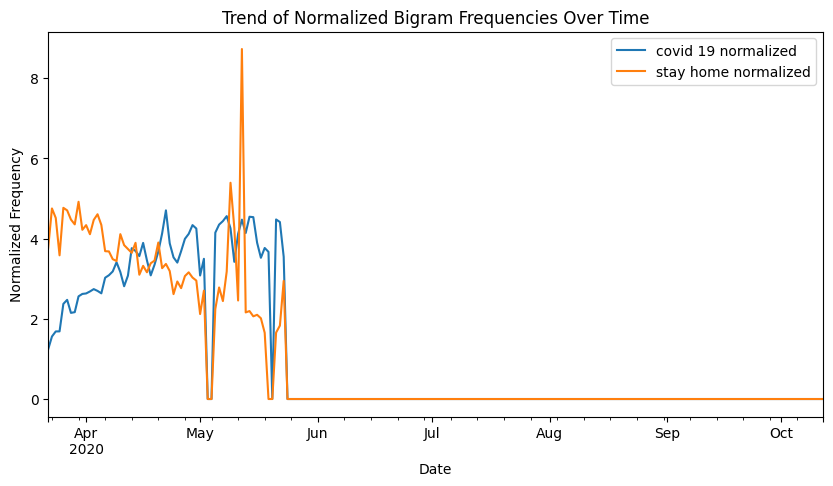

In [44]:
import matplotlib.pyplot as plt

# Calculating the mean values for each bigram
mean_covid_19 = df['Counts'].apply(lambda x: x.get('covid 19', 0)).mean()
mean_stay_home = df['Counts'].apply(lambda x: x.get('stay home', 0)).mean()

# Normalizing the frequencies by dividing by the mean frequency
df['covid 19 normalized'] = df['Counts'].apply(lambda x: x.get('covid 19', 0) / mean_covid_19 if mean_covid_19 != 0 else 0)
df['stay home normalized'] = df['Counts'].apply(lambda x: x.get('stay home', 0) / mean_stay_home if mean_stay_home != 0 else 0)

# Plotting the normalized data
df[['covid 19 normalized', 'stay home normalized']].plot(figsize=(10, 5))
plt.title('Trend of Normalized Bigram Frequencies Over Time')
plt.ylabel('Normalized Frequency')
plt.xlabel('Date')
plt.show()


In [45]:
df.head()

,_id,Counts,covid 19 normalized,stay home normalized
Date,,,,
2020-03-22,663c2070b60ba3adaa977c2d,"{'covid 19': 63056, 'stay home': 4573, 'positi...",1.237522,3.761174
2020-03-23,663c2070b60ba3adaa977c2e,"{'covid 19': 79421, 'stay home': 5777, 'corona...",1.558697,4.751432
2020-03-24,663c2070b60ba3adaa977c2f,"{'covid 19': 85876, 'coronavirus pandemic': 58...",1.685381,4.514560
2020-03-25,663c2070b60ba3adaa977c30,"{'covid 19': 85937, 'prince charles': 6287, 'c...",1.686579,3.582697
2020-03-26,663c2070b60ba3adaa977c31,"{'covid 19': 120843, 'coronavirus pandemic': 8...",2.371635,4.767059


In [46]:
df.tail()

,_id,Counts,covid 19 normalized,stay home normalized
Date,,,,
2020-10-08,663c2070b60ba3adaa977cf5,"{'covid 19 pandemic': 5384, 'covid 19 cases': ...",0.0,0.0
2020-10-09,663c2070b60ba3adaa977cf6,"{'covid 19 cases': 6380, 'covid 19 pandemic': ...",0.0,0.0
2020-10-10,663c2070b60ba3adaa977cf7,"{'covid 19 cases': 4959, 'covid 19 pandemic': ...",0.0,0.0
2020-10-11,663c2070b60ba3adaa977cf8,"{'covid 19 cases': 5060, 'covid 19 pandemic': ...",0.0,0.0
2020-10-12,663c2070b60ba3adaa977cf9,"{'covid 19 cases': 5195, 'covid 19 pandemic': ...",0.0,0.0


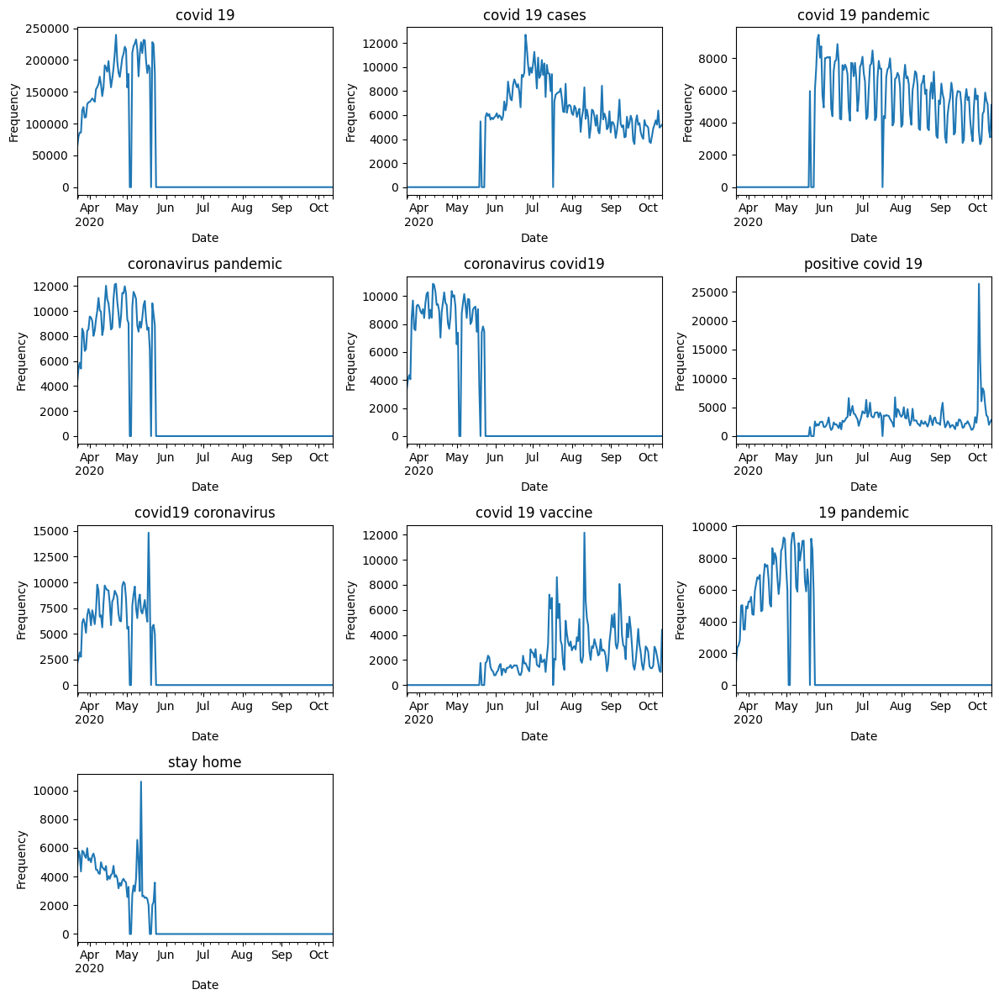

In [47]:
import matplotlib.pyplot as plt

# Example for tracking the trend of keywords
keywords = ['covid 19', 'covid 19 cases', 'covid 19 pandemic', 'coronavirus pandemic',
            'coronavirus covid19', 'positive covid 19', 'covid19 coronavirus',
            'covid 19 vaccine', '19 pandemic', 'stay home']

# Calculate the grid dimensions
num_plots = len(keywords)
num_cols = 3  # Number of columns in the grid
num_rows = -(-num_plots // num_cols)  # Calculate the number of rows needed

# Create subplots with grid layout
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(12, 3*num_rows))

# Flatten axes if needed
if num_plots != num_rows * num_cols:
    axes = axes.flatten()

# Plot each keyword's trend
for i, keyword in enumerate(keywords):
    df[keyword] = df['Counts'].apply(lambda x: x.get(keyword, 0))
    ax = axes[i]
    df[keyword].plot(ax=ax, title=keyword)
    ax.set_ylabel('Frequency')
    ax.set_xlabel('Date')

# Hide empty subplots
for i in range(num_plots, num_rows * num_cols):
    axes[i].axis('off')

plt.tight_layout()
plt.show()


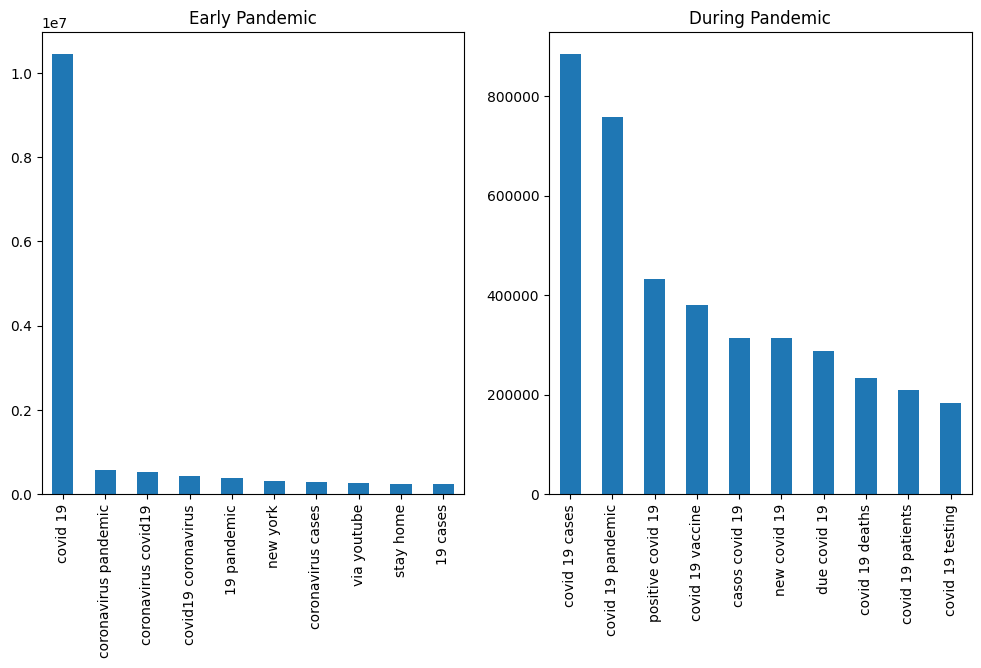

In [48]:
# Assuming 'pre-pandemic' and 'during-pandemic' as two periods
pre_pandemic = df.loc['2020-03-22':'2020-06-01']
during_pandemic = df.loc['2020-06-02':'2020-10-12']

pre_pandemic_counts = pre_pandemic['Counts'].apply(pd.Series).sum()
during_pandemic_counts = during_pandemic['Counts'].apply(pd.Series).sum()

fig, ax = plt.subplots(1, 2, figsize=(12, 6))
pre_pandemic_counts.nlargest(10).plot(kind='bar', ax=ax[0], title='Early Pandemic')
during_pandemic_counts.nlargest(10).plot(kind='bar', ax=ax[1], title='During Pandemic')
plt.show()


  Using cached seaborn-0.13.2-py3-none-any.whl.metadata (5.4 kB)
Using cached seaborn-0.13.2-py3-none-any.whl (294 kB)


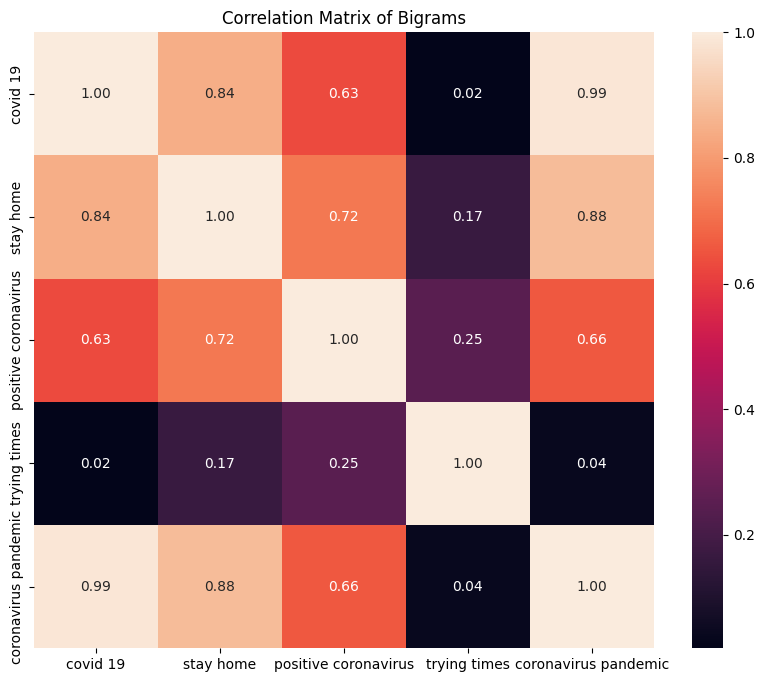

In [50]:
# Generate a larger DataFrame of bigrams for correlation analysis
bigram_df = df['Counts'].apply(pd.Series).fillna(0)
correlations = bigram_df.corr()

# Visualize with a heatmap
!pip install seaborn
import seaborn as sns

plt.figure(figsize=(10, 8))
sns.heatmap(correlations.iloc[:5, :5], annot=True, fmt=".2f")
plt.title('Correlation Matrix of Bigrams')
plt.show()
